## Preparar el entorno de Colab



In [ ]:
# Mostrar gráficos en línea
%matplotlib inline

# Importar librerías necesarias
import os
import random
from typing import List, Tuple, Dict

import pandas as pd
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
from google.colab import files

# Subir archivo manualmente
uploaded = files.upload()


Saving ua-airports.csv to ua-airports.csv


In [ ]:
# Reemplaza con el nombre correcto de tu archivo si es diferente
df = pd.read_csv("ua-airports.csv")

# Verifica que la data se haya cargado
df.head()

,id,ident,type,name,latitude_deg,longitude_deg,elevation_ft,continent,country_name,iso_country,...,scheduled_service,gps_code,icao_code,iata_code,local_code,home_link,wikipedia_link,keywords,score,last_updated
0,6467,UKBB,large_airport,Boryspil International Airport,50.345001,30.894699,427.0,EU,Ukraine,UA,...,1,UKBB,UKBB,KBP,NaN,https://kbp.aero/en/,https://en.wikipedia.org/wiki/Boryspil_Interna...,"Borispol, Міжнародний аеропорт ""Бориспіль"", Kyiv",1600,2022-11-20T09:05:31+00:00
1,6478,UKKK,medium_airport,Ihor Sikorsky Kyiv International Airport (Zhul...,50.401940,30.451940,587.0,EU,Ukraine,UA,...,1,UKKK,UKKK,IEV,NaN,https://iev.aero/,https://en.wikipedia.org/wiki/Kyiv_Internation...,"Міжнародний аеропорт ""Київ"", Kiev",750,2022-11-20T09:02:37+00:00
2,6487,UKOO,medium_airport,Odessa International Airport,46.426800,30.676500,172.0,EU,Ukraine,UA,...,1,UKOO,UKOO,ODS,NaN,http://www.airport.od.ua/,https://en.wikipedia.org/wiki/Odessa_Internati...,"Odesa Central, Міжнародний аеропорт Одеса",750,2021-11-20T16:17:31+00:00
3,6481,UKLL,large_airport,Lviv International Airport,49.812500,23.956100,1071.0,EU,Ukraine,UA,...,1,UKLL,UKLL,LWO,NaN,http://www.airport.lviv.ua/index.php?id=home&L=1,https://en.wikipedia.org/wiki/Lviv_Internation...,"Міжнародний аеропорт ""Львів""",1200,2021-08-01T05:06:08+00:00
4,6474,UKFF,medium_airport,Simferopol International Airport,45.052200,33.975101,639.0,EU,Ukraine,UA,...,1,UKFF,UKFF,SIP,URFF,https://new.sipaero.ru/,https://en.wikipedia.org/wiki/Simferopol_Inter...,NaN,750,2021-12-18T15:15:44+00:00


In [ ]:
# Diccionario con los ICAO codes y sus nuevos estados
actualizaciones = {
    "UKKK": "closed",
    "UKOO": "medium_airport",
    "UKFF": "closed",
    "UKHH": "medium_airport",
    "UKDD": "closed",
    "UKLI": "closed",
    "UKLU": "medium_airport",
    "UKDE": "closed",
    "UKLN": "medium_airport",
    "UKKM": "closed",
    "UKKE": "medium_airport",
    "UA-0028": "medium_airport",
    "UKFB": "closed",
    "UKWW": "closed",
    "UKDR": "medium_airport",
    "UKLR": "medium_airport",
    "UKOH": "closed",
    "UKCM": "closed",
    "UKON": "medium_airport",
    "UKDB": "closed",
    "UA-0025": "medium_airport",
    "UKFY": "closed",
    "UKFG": "closed",
    "UA-0022": "medium_airport",
    "UKLH": "medium_airport",
    "UA-0012": "closed",
    "UA-0047": "medium_airport",
    "UA-0020": "closed",
    "UA-0005": "medium_airport",
    "UKFI": "closed",
    "UA-0010": "closed",
    "UKKO": "medium_airport"
}

In [ ]:
# Aplicar las actualizaciones
df['type'] = df['ident'].apply(lambda x: actualizaciones.get(x, df.loc[df['ident'] == x, 'type'].values[0]))

In [ ]:
from itertools import combinations
from math import radians, sin, cos, sqrt, atan2

# Función para calcular distancia entre dos puntos geográficos (Haversine)
def haversine(lat1, lon1, lat2, lon2):
    R = 6371  # radio Tierra en km
    dlat = radians(lat2 - lat1)
    dlon = radians(lon2 - lon1)
    a = sin(dlat / 2)**2 + cos(radians(lat1)) * cos(radians(lat2)) * sin(dlon / 2)**2
    c = 2 * atan2(sqrt(a), sqrt(1 - a))
    return R * c

# Crear lista de edges con pesos
edges = []

# Crear todas las combinaciones posibles (pares) de aeropuertos
for (i, row1), (j, row2) in combinations(df.iterrows(), 2):
    source = row1['ident']
    target = row2['ident']

    # Calculamos distancia
    dist = haversine(row1['latitude_deg'], row1['longitude_deg'],
                     row2['latitude_deg'], row2['longitude_deg'])

    # Diferencia absoluta del score
    score_diff = abs(row1['score'] - row2['score'])

    # Por ejemplo, podríamos definir peso como la distancia o alguna función de distancia y score
    weight = dist  # o weight = dist / (score_diff + 1) para considerar score

    edges.append((source, target, weight))

# Crear grafo con NetworkX
G = nx.Graph()
G.add_weighted_edges_from(edges)

print(f"Número de nodos: {G.number_of_nodes()}")
print(f"Número de edges: {G.number_of_edges()}")


Número de nodos: 283
Número de edges: 39903


In [ ]:
def print_network_stats(G: nx.Graph) -> None:
    num_nodes = G.number_of_nodes()


    num_edges = G.number_of_edges()


    # Grado de cada nodo (número de conexiones)
    degrees = dict(G.degree())
    for node, degree in degrees.items():
        print(f"{node}: {degree}")

    # Grado promedio
    avg_degree = sum(degrees.values()) / num_nodes
    print(f"Average degree: {avg_degree:.2f}")

    # Densidad (proporción de edges existentes sobre el máximo posible)
    density = nx.density(G)
    print(f"Density: {density:.4f}")

    # Coeficiente de clustering promedio (qué tan agrupados están los nodos)
    avg_clustering_coefficient = nx.average_clustering(G)
    print(f"Average clustering coefficient: {avg_clustering_coefficient:.4f}")

    # Diámetro de la red (la distancia más larga entre cualquier par de nodos)
    if nx.is_connected(G):
        diameter = nx.diameter(G)
        print(f"Network Diameter: {diameter}")
    else:
        print("Network Diameter: Graph is not connected")

    # Longitud promedio del camino más corto entre pares de nodos
    if nx.is_connected(G):
        avg_shortest_path_length = nx.average_shortest_path_length(G)
        print(f"Average shortest path length: {avg_shortest_path_length:.2f}")
    else:
        print("Average shortest path length: Graph is not connected")

# Ejecuta la función con tu grafo
print_network_stats(G)


UKBB: 282
UKKK: 282
UKOO: 282
UKLL: 282
UKFF: 282
UKHH: 282
UKDD: 282
UKLI: 282
UKLU: 282
UKDE: 282
UA-9862: 282
UKLN: 282
UKKM: 282
UKKE: 282
UA-9863: 282
UA-0028: 282
UKFB: 282
UKWW: 282
UA-0075: 282
UA-0076: 282
UA-0081: 282
UA-0039: 282
UA-0052: 282
UA-0177: 282
UA-0009: 282
UA-0038: 282
UKHP: 282
UA-6709: 282
UA-0095: 282
UA-0016: 282
UKFW: 282
UA-0143: 282
UA-2644: 282
UA-8143: 282
UKHS: 282
UA-0082: 282
UKLT: 282
UA-0097: 282
UA-6118: 282
UA-0169: 282
UA-0059: 282
UA-0098: 282
UA-9861: 282
UKGW: 282
UA-0042: 282
UA-0058: 282
UKFV: 282
UA-0114: 282
UKKV: 282
UA-0174: 282
UA-0043: 282
UA-9867: 282
UA-0140: 282
UA-0041: 282
UA-0167: 282
UA-0040: 282
UA-0069: 282
UA-0124: 282
UA-0064: 282
UA-0153: 282
UA-0154: 282
UA-0176: 282
UA-0147: 282
UA-0071: 282
UA-0072: 282
UKDR: 282
UKLR: 282
UKOH: 282
UKCM: 282
UKON: 282
UKDB: 282
UA-0025: 282
UKFY: 282
UKFG: 282
UA-0022: 282
UKLH: 282
UA-0012: 282
UA-0047: 282
UA-0020: 282
UA-0005: 282
UKFI: 282
UA-0010: 282
UKKO: 282
UA-0083: 282
UA-0079

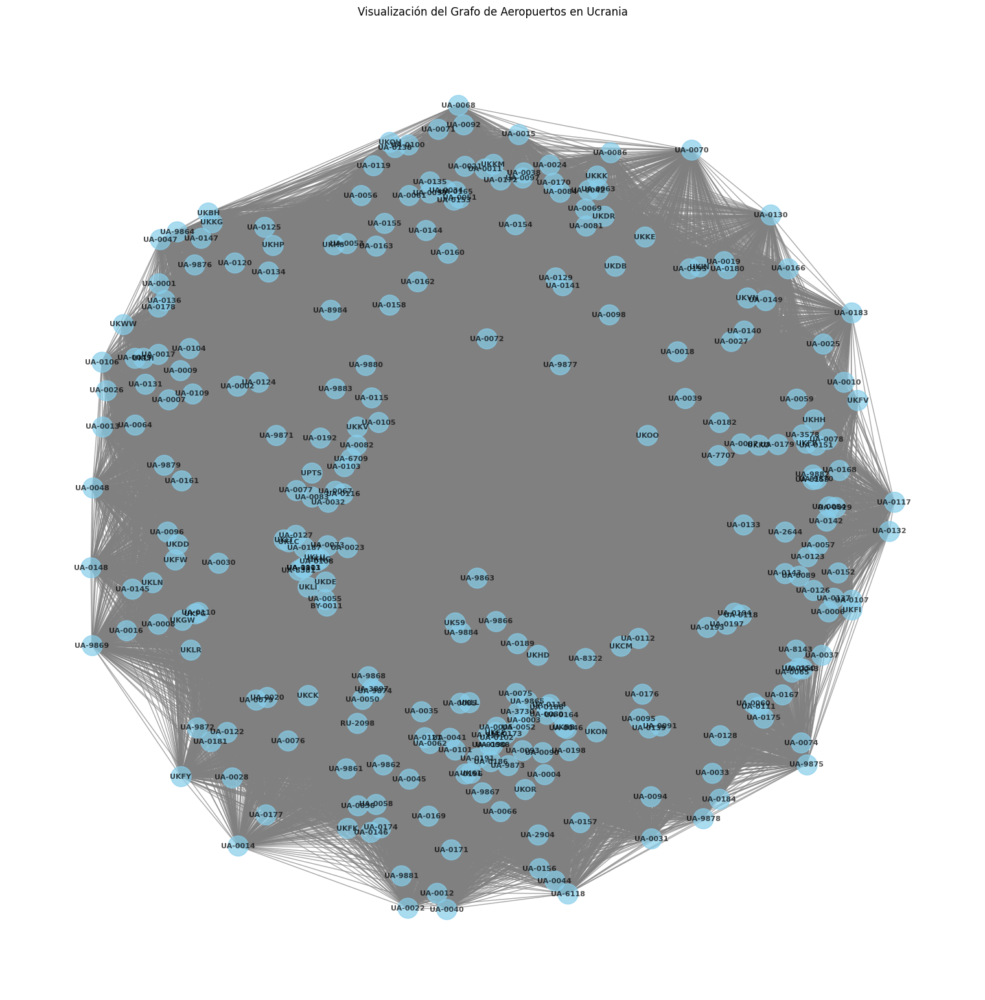

In [ ]:
import matplotlib.pyplot as plt
import networkx as nx

# Visualización básica
plt.figure(figsize=(15, 15))
pos = nx.spring_layout(G, k=0.15, iterations=20)  # Layout para distribuir los nodos
nx.draw(G, pos, with_labels=True, node_color='skyblue', node_size=500, font_size=8, font_weight='bold', edge_color='gray', alpha=0.7)
plt.title("Visualización del Grafo de Aeropuertos en Ucrania")
plt.show()

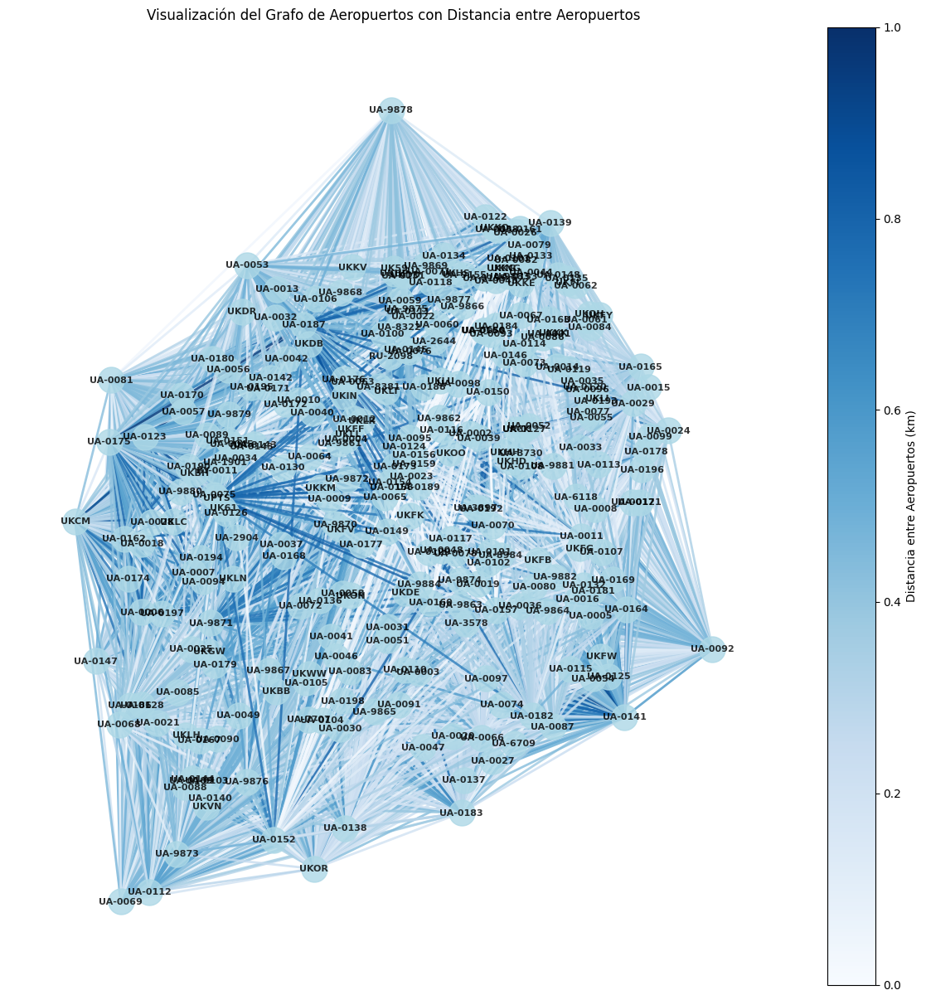

In [ ]:
# Visualización del grafo con aristas ponderadas
plt.figure(figsize=(15, 15))

# Calculamos las posiciones de los nodos usando un layout de fuerza
pos = nx.spring_layout(G, k=0.15, iterations=20)

# Extraemos los pesos de las aristas
edge_weights = [G[u][v]['weight'] for u, v in G.edges()]

# Dibuja el grafo con los pesos de las aristas y nodos
# Capturamos los ejes actuales para pasarlos a colorbar
ax = plt.gca()
nx.draw(G, pos, with_labels=True, node_color='lightblue', node_size=500, font_size=8, font_weight='bold', edge_color=edge_weights, edge_cmap=plt.cm.Blues, width=2.0, alpha=0.8, ax=ax) # Specify axes for draw

plt.title("Visualización del Grafo de Aeropuertos con Distancia entre Aeropuertos")
# Pasamos los ejes capturados a colorbar
plt.colorbar(plt.cm.ScalarMappable(cmap=plt.cm.Blues), ax=ax, label='Distancia entre Aeropuertos (km)')
plt.show()

1 forma de análisis

Nodos: 283, Aristas filtradas: 1851


ValueError: Unable to determine Axes to steal space for Colorbar. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.

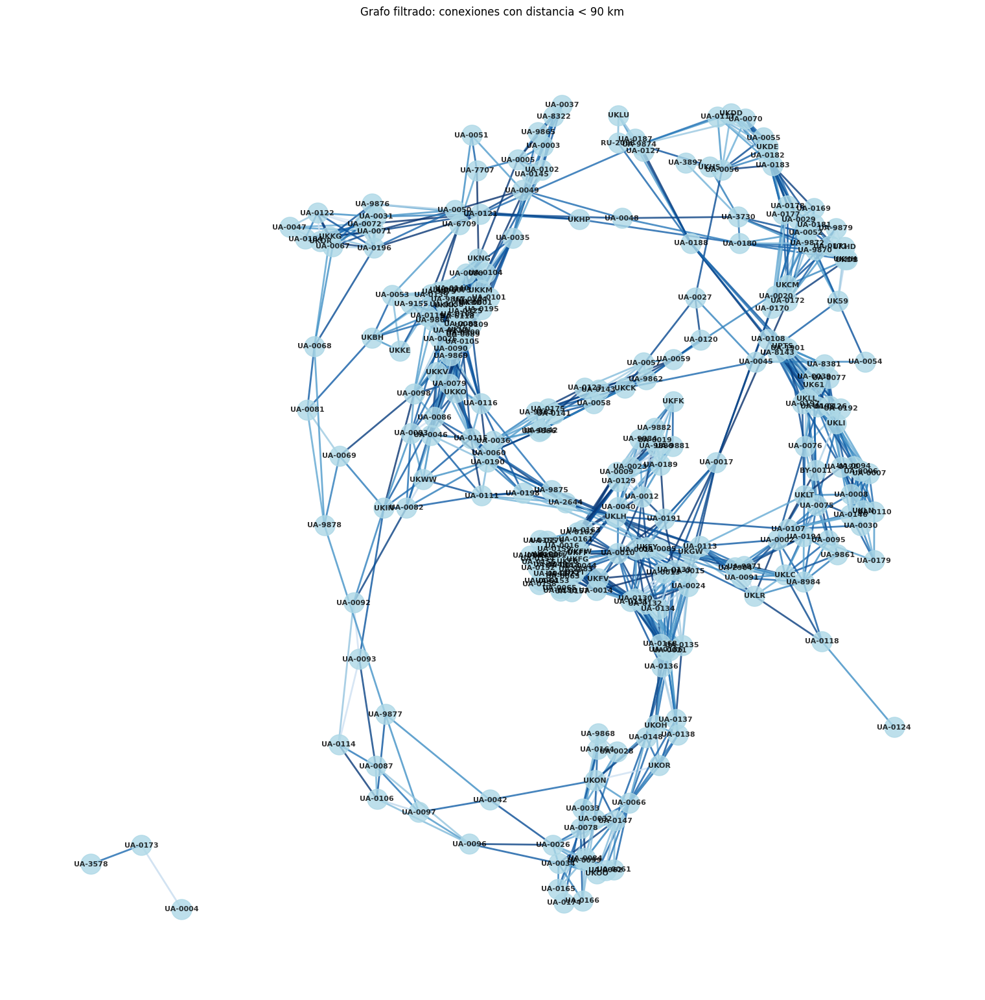

In [ ]:
# Filtrar aristas con peso menor a un umbral
umbral = 90  # kilómetros

G_filtrado = nx.Graph()

# Añadir nodos igual
G_filtrado.add_nodes_from(G.nodes(data=True))

# Añadir aristas con peso menor al umbral
for u, v, w in G.edges(data='weight'):
    if w < umbral:
        G_filtrado.add_edge(u, v, weight=w)

print(f"Nodos: {G_filtrado.number_of_nodes()}, Aristas filtradas: {G_filtrado.number_of_edges()}")

# Visualizar grafo filtrado
plt.figure(figsize=(15, 15))
pos = nx.spring_layout(G_filtrado, k=0.15, iterations=20)
edge_weights = [G_filtrado[u][v]['weight'] for u, v in G_filtrado.edges()]
nx.draw(G_filtrado, pos, with_labels=True, node_color='lightblue', node_size=500,
        font_size=8, font_weight='bold', edge_color=edge_weights, edge_cmap=plt.cm.Blues, width=2.0, alpha=0.8)
plt.title(f"Grafo filtrado: conexiones con distancia < {umbral} km")
plt.colorbar(plt.cm.ScalarMappable(cmap=plt.cm.Blues), label='Distancia (km)')
plt.show()

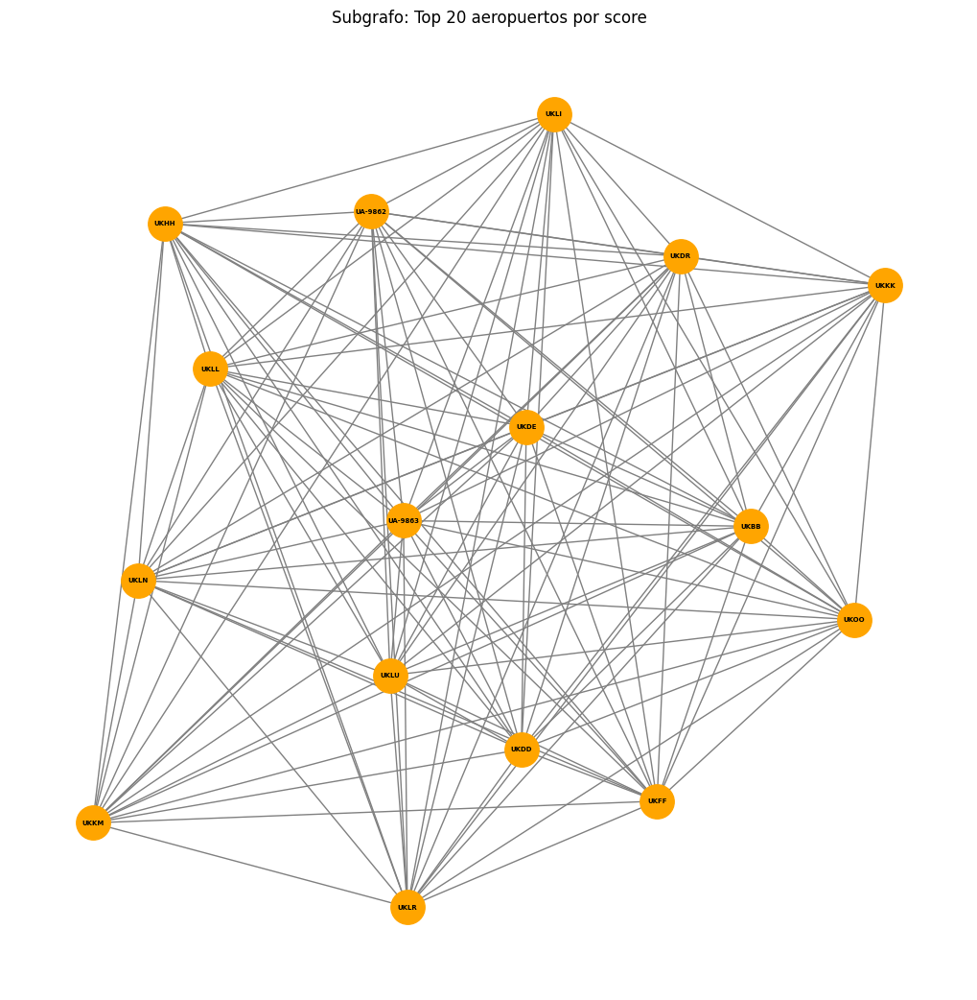

In [ ]:
# Seleccionar top 20 aeropuertos por score
top_airports = df.nlargest(16, 'score')['ident'].tolist()

# Subgrafo con estos nodos
G_sub = G.subgraph(top_airports)

# Visualización
plt.figure(figsize=(10, 10))
pos = nx.spring_layout(G_sub, k=0.3)
nx.draw(G_sub, pos, with_labels=True, node_color='orange', node_size=650, font_size=5, font_weight='bold', edge_color='gray')
plt.title("Subgrafo: Top 20 aeropuertos por score")
plt.show()

2da forma por tipo de tamaño

- minium -- 50
- helucoper -- 0
- medium -- 250 a 750 -- uno atacado
- large -- 1200 y uno 1600 -- uno atacado

3ra forma categorías
- closed -- Rusia unicamente atacó a un dos puertos importantes pero se ha centrado sobre todo en bases aereas
- heliport -- no los ha atacado



#Análisis:

## excluir a los pequeños, a los cerrados
- puntos para desembarco de soldados

## Relevancia
- estudio
-
-


In [ ]:
closed_df = df[df['type'] == 'closed']

In [ ]:
from itertools import combinations
from math import radians, sin, cos, sqrt, atan2

def haversine(lat1, lon1, lat2, lon2):
    R = 6371
    dlat = radians(lat2 - lat1)
    dlon = radians(lon2 - lon1)
    a = sin(dlat/2)**2 + cos(radians(lat1)) * cos(radians(lat2)) * sin(dlon/2)**2
    c = 2 * atan2(sqrt(a), sqrt(1 - a))
    return R * c

# Crear edges solo entre cerrados
edges_closed = []
for (i, row1), (j, row2) in combinations(closed_df.iterrows(), 2):
    dist = haversine(row1['latitude_deg'], row1['longitude_deg'],
                     row2['latitude_deg'], row2['longitude_deg'])
    edges_closed.append((row1['ident'], row2['ident'], dist))

In [ ]:
import networkx as nx

G_closed = nx.Graph()
G_closed.add_weighted_edges_from(edges_closed)

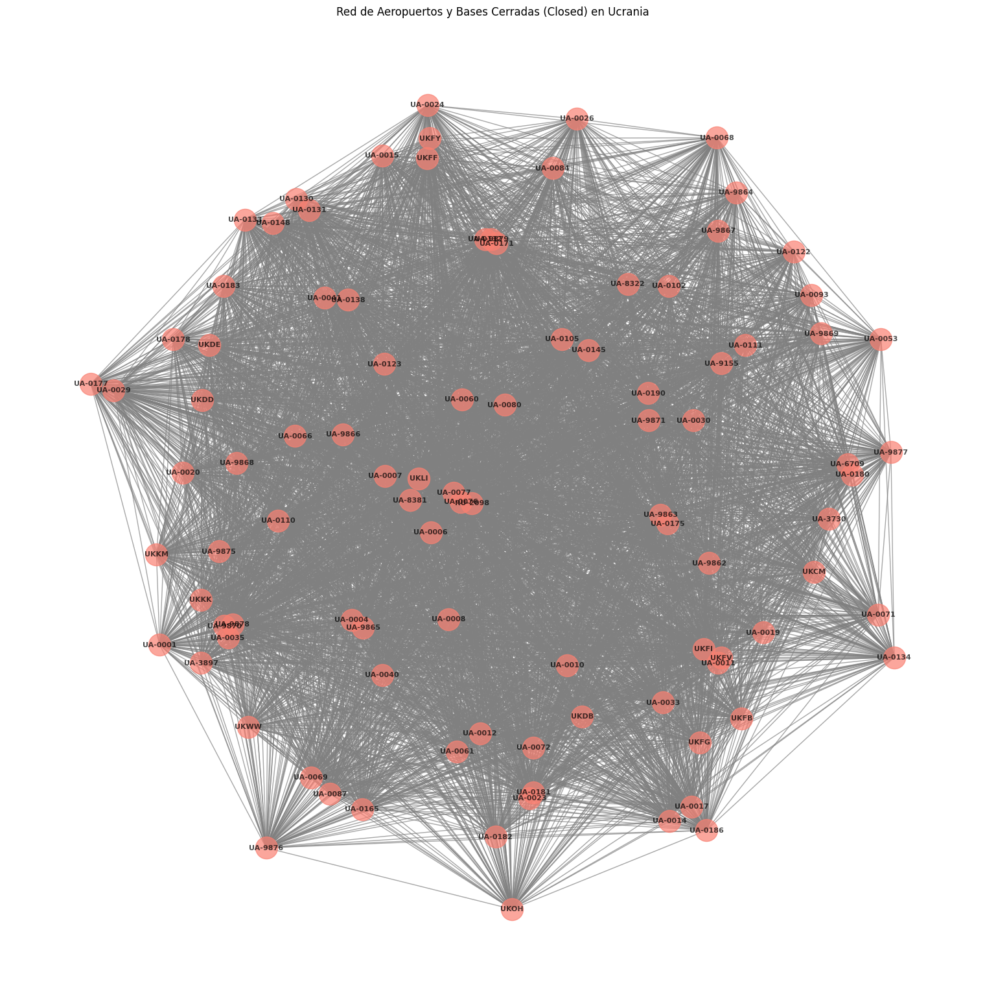

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(15, 15))
pos = nx.spring_layout(G_closed, k=0.3)
nx.draw(G_closed, pos, with_labels=True, node_color='salmon', node_size=600, font_size=8,
        font_weight='bold', edge_color='gray', alpha=0.7)
plt.title("Red de Aeropuertos y Bases Cerradas (Closed) en Ucrania")
plt.show()

In [ ]:
print(f"Número de nodos (closed): {G_closed.number_of_nodes()}")
print(f"Número de edges: {G_closed.number_of_edges()}")

# Grado promedio, densidad, etc.
from networkx import average_clustering, density, is_connected, diameter, average_shortest_path_length

degrees = dict(G_closed.degree())
avg_deg = sum(degrees.values()) / G_closed.number_of_nodes()
print(f"Grado promedio: {avg_deg:.2f}")
print(f"Densidad: {density(G_closed):.4f}")
print(f"Clustering promedio: {average_clustering(G_closed):.4f}")
if is_connected(G_closed):
    print(f"Diámetro: {diameter(G_closed)}")
    print(f"Longitud promedio del camino más corto: {average_shortest_path_length(G_closed):.2f}")
else:
    print("La red no es conexa (hay nodos o grupos aislados).")

Número de nodos (closed): 98
Número de edges: 4753
Grado promedio: 97.00
Densidad: 1.0000
Clustering promedio: 1.0000
Diámetro: 1
Longitud promedio del camino más corto: 1.00


In [ ]:
!pip install geopandas shapely contextily --quiet
import geopandas as gpd
from shapely.geometry import Point
import matplotlib.pyplot as plt

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 95.2 MB/s eta 0:00:00


In [ ]:
# Filtramos los cerrados
closed_df = df[df['type'] == 'closed']

# Creamos geometría a partir de lat/lon
geometry = [Point(xy) for xy in zip(closed_df['longitude_deg'], closed_df['latitude_deg'])]

# Definimos el GeoDataFrame
gdf_closed = gpd.GeoDataFrame(closed_df, geometry=geometry, crs='EPSG:4326')

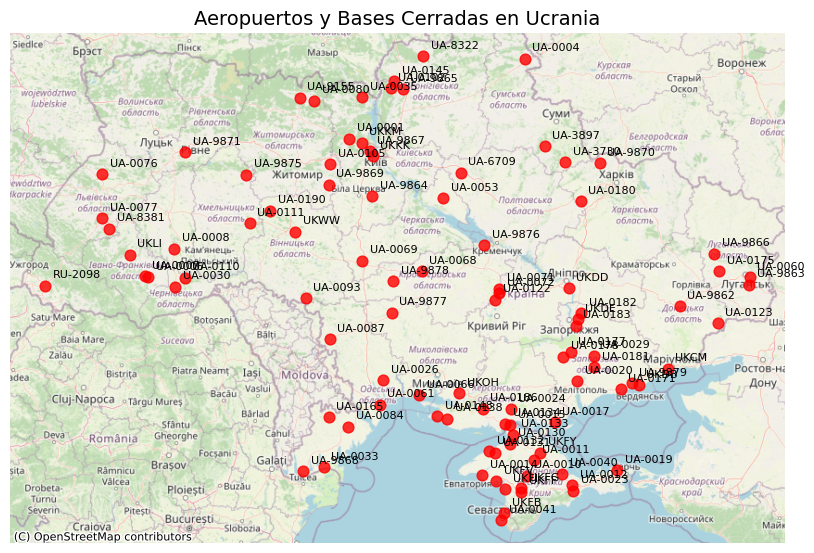

In [ ]:
# Instalar dependencias necesarias
!pip install geopandas shapely contextily --quiet

# Importar librerías
import geopandas as gpd
from shapely.geometry import Point
import contextily as ctx
import matplotlib.pyplot as plt

# Crear GeoDataFrame solo con aeropuertos cerrados
closed_df = df[df['type'] == 'closed']
geometry = [Point(xy) for xy in zip(closed_df['longitude_deg'], closed_df['latitude_deg'])]
gdf_closed = gpd.GeoDataFrame(closed_df, geometry=geometry, crs='EPSG:4326')

# Convertir a Web Mercator para usar tiles (OpenStreetMap)
gdf_closed_web = gdf_closed.to_crs(epsg=3857)

# Crear figura
fig, ax = plt.subplots(figsize=(10, 12))
gdf_closed_web.plot(ax=ax, color='red', markersize=60, alpha=0.8)

# Agregar etiquetas con códigos
for x, y, label in zip(gdf_closed_web.geometry.x, gdf_closed_web.geometry.y, gdf_closed_web['ident']):
    ax.text(x + 20000, y + 20000, label, fontsize=8)

# Agregar fondo de mapa base (OSM)
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Título y ajustes finales
plt.title("Aeropuertos y Bases Cerradas en Ucrania", fontsize=14)
plt.axis('off')
plt.show()



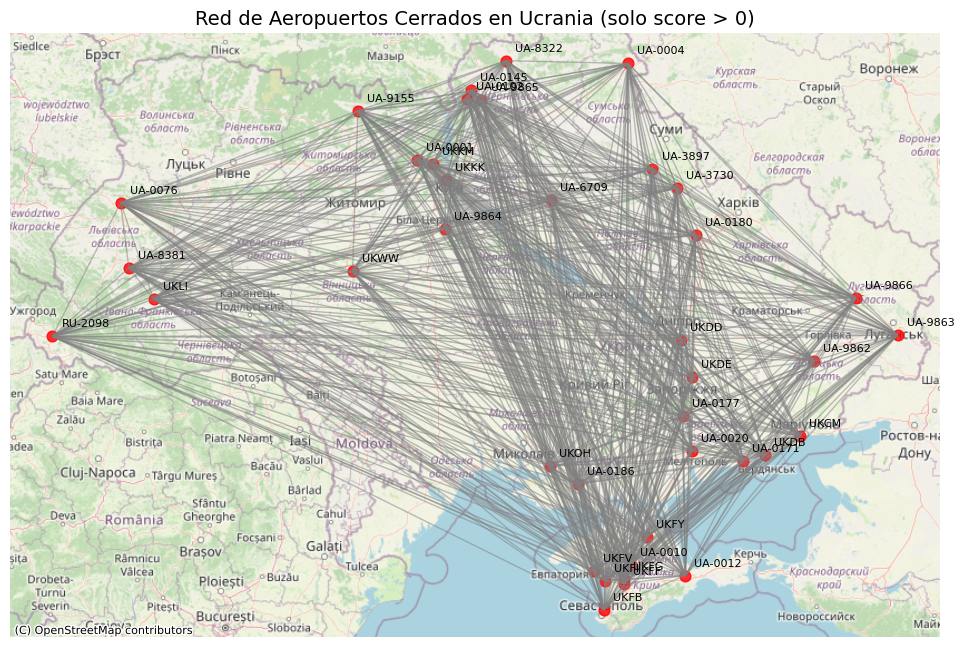

In [ ]:
from itertools import combinations
from shapely.geometry import LineString
import geopandas as gpd
from shapely.geometry import Point
import contextily as ctx
import matplotlib.pyplot as plt

# 1. Filtrar aeropuertos cerrados con score > 0
closed_df = df[(df['type'] == 'closed') & (df['score'] > 0)].copy()

# 2. Crear geometría de puntos
closed_df['geometry'] = [Point(xy) for xy in zip(closed_df['longitude_deg'], closed_df['latitude_deg'])]
gdf_closed = gpd.GeoDataFrame(closed_df, geometry='geometry', crs='EPSG:4326')

# 3. Crear líneas entre pares de nodos
edges = []
for (i, row1), (j, row2) in combinations(gdf_closed.iterrows(), 2):
    point1 = row1['geometry']
    point2 = row2['geometry']
    line = LineString([point1, point2])
    edges.append({'source': row1['ident'], 'target': row2['ident'], 'geometry': line})

# 4. Convertir a GeoDataFrame
gdf_edges = gpd.GeoDataFrame(edges, geometry='geometry', crs='EPSG:4326')

# 5. Proyección a Web Mercator
gdf_closed_web = gdf_closed.to_crs(epsg=3857)
gdf_edges_web = gdf_edges.to_crs(epsg=3857)

# 6. Dibujar mapa
fig, ax = plt.subplots(figsize=(12, 14))

# Líneas
gdf_edges_web.plot(ax=ax, color='gray', linewidth=1, alpha=0.5)

# Nodos
gdf_closed_web.plot(ax=ax, color='red', markersize=60, alpha=0.8)

# Etiquetas
for x, y, label in zip(gdf_closed_web.geometry.x, gdf_closed_web.geometry.y, gdf_closed_web['ident']):
    ax.text(x + 20000, y + 20000, label, fontsize=8)

# Mapa base
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Título
plt.title("Red de Aeropuertos Cerrados en Ucrania (solo score > 0)", fontsize=14)
plt.axis('off')
plt.show()


In [ ]:
df[(df['type'] == 'closed') & (df['score'] > 50)]

,id,ident,type,name,latitude_deg,longitude_deg,elevation_ft,continent,country_name,iso_country,...,scheduled_service,gps_code,icao_code,iata_code,local_code,home_link,wikipedia_link,keywords,score,last_updated
1,6478,UKKK,closed,Ihor Sikorsky Kyiv International Airport (Zhul...,50.401940,30.451940,587.0,EU,Ukraine,UA,...,1,UKKK,UKKK,IEV,NaN,https://iev.aero/,https://en.wikipedia.org/wiki/Kyiv_Internation...,"Міжнародний аеропорт ""Київ"", Kiev",750,2022-11-20T09:02:37+00:00
4,6474,UKFF,closed,Simferopol International Airport,45.052200,33.975101,639.0,EU,Ukraine,UA,...,1,UKFF,UKFF,SIP,URFF,https://new.sipaero.ru/,https://en.wikipedia.org/wiki/Simferopol_Inter...,NaN,750,2021-12-18T15:15:44+00:00
6,6471,UKDD,closed,Dnipro International Airport,48.357201,35.100601,481.0,EU,Ukraine,UA,...,1,UKDD,UKDD,DNK,NaN,NaN,https://en.wikipedia.org/wiki/Dnipro_Internati...,"Dnipropetrovsk, Міжнародний аеропорт «Дніпро»",750,2022-10-13T16:03:56+00:00
7,6480,UKLI,closed,Ivano-Frankivsk International Airport,48.884201,24.686100,919.0,EU,Ukraine,UA,...,1,UKLI,UKLI,IFO,NaN,http://www.aeroportifua.ifrastudio.com/index.p...,https://en.wikipedia.org/wiki/Ivano-Frankivsk_...,Міжнародний аеропорт Івано-Франківськ,750,2009-02-18T19:46:15+00:00
9,6472,UKDE,closed,Zaporizhzhia International Airport,47.867001,35.315701,373.0,EU,Ukraine,UA,...,1,UKDE,UKDE,OZH,NaN,NaN,https://en.wikipedia.org/wiki/Zaporizhia_Inter...,"Zaporozhye Airport, Міжнародний аеропорт Запор...",750,2009-03-19T16:43:50+00:00
10,6468,UA-9862,closed,Donetsk Sergei Prokofiev International Airport,48.075072,37.725270,791.0,EU,Ukraine,UA,...,0,NaN,NaN,NaN,NaN,http://airport.dn.ua/,https://en.wikipedia.org/wiki/Donetsk_Internat...,"Міжнародний аеропорт ""Донецьк"", UKCC, DOK",1200,2025-02-25T14:38:08+00:00
12,6479,UKKM,closed,Hostomel Airport,50.603500,30.191900,517.0,EU,Ukraine,UA,...,0,UKKM,NaN,NaN,NaN,NaN,https://en.wikipedia.org/wiki/Hostomel_Airport,"Antonov International Airport, Аеропорт „Антон...",750,2023-03-07T18:40:44+00:00
14,6470,UA-9863,closed,Luhansk International Airport,48.417400,39.374100,636.0,EU,Ukraine,UA,...,1,NaN,NaN,NaN,NaN,NaN,https://en.wikipedia.org/wiki/Luhansk_Internat...,"Lugansk International Airport, Міжнародний аер...",750,2025-02-25T14:38:08+00:00
16,44293,UKFB,closed,Sevastopol International Airport / Belbek Air ...,44.691822,33.574620,344.0,EU,Ukraine,UA,...,0,UKFB,UKFB,UKS,NaN,NaN,https://en.wikipedia.org/wiki/Sevastopol_Inter...,"Севастополь,Бельбек",250,2022-10-20T12:49:18+00:00
17,30535,UKWW,closed,Vinnytsia/Gavyryshivka International Airport,49.242531,28.613778,961.0,EU,Ukraine,UA,...,0,UKWW,UKWW,VIN,NaN,NaN,https://en.wikipedia.org/wiki/Havryshivka_Vinn...,"Gavrishevka Airport, Gavrishivka Airport, Аэро...",250,2022-03-08T07:27:16+00:00


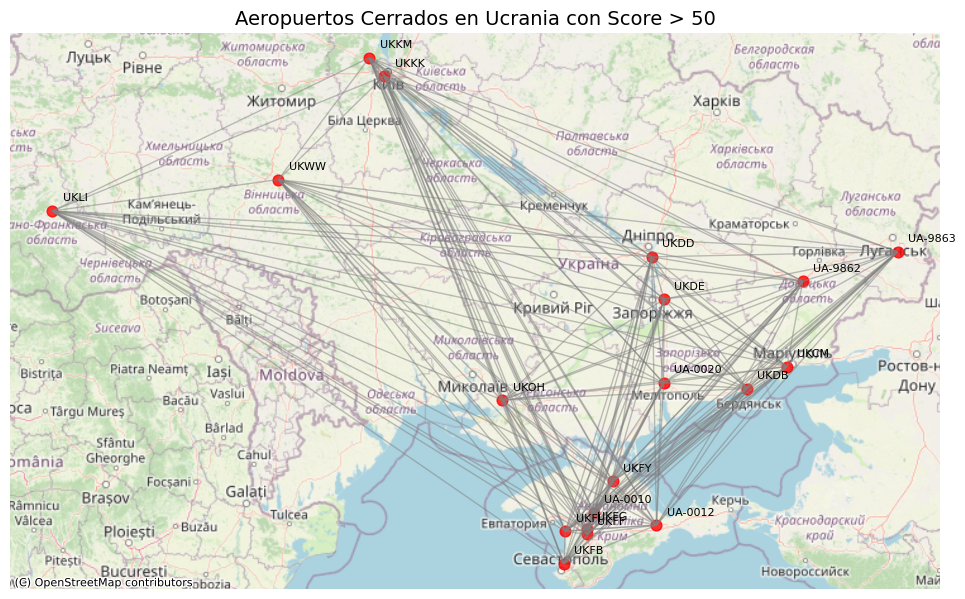

In [ ]:
# 1. Filtrar aeropuertos cerrados con score > 50
closed_df = df[(df['type'] == 'closed') & (df['score'] > 50)].copy()

# 2. Crear geometría de puntos
closed_df['geometry'] = [Point(xy) for xy in zip(closed_df['longitude_deg'], closed_df['latitude_deg'])]
gdf_closed = gpd.GeoDataFrame(closed_df, geometry='geometry', crs='EPSG:4326')

# 3. Crear líneas entre pares de nodos
edges = []
for (i, row1), (j, row2) in combinations(gdf_closed.iterrows(), 2):
    point1 = row1['geometry']
    point2 = row2['geometry']
    line = LineString([point1, point2])
    edges.append({'source': row1['ident'], 'target': row2['ident'], 'geometry': line})

# 4. Convertir a GeoDataFrame
gdf_edges = gpd.GeoDataFrame(edges, geometry='geometry', crs='EPSG:4326')

# 5. Proyección a Web Mercator
gdf_closed_web = gdf_closed.to_crs(epsg=3857)
gdf_edges_web = gdf_edges.to_crs(epsg=3857)

# 6. Dibujar mapa
fig, ax = plt.subplots(figsize=(12, 14))

# Líneas
gdf_edges_web.plot(ax=ax, color='gray', linewidth=1, alpha=0.5)

# Nodos
gdf_closed_web.plot(ax=ax, color='red', markersize=60, alpha=0.8)

# Etiquetas
for x, y, label in zip(gdf_closed_web.geometry.x, gdf_closed_web.geometry.y, gdf_closed_web['ident']):
    ax.text(x + 20000, y + 20000, label, fontsize=8)

# Mapa base
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Título
plt.title("Aeropuertos Cerrados en Ucrania con Score > 50", fontsize=14)
plt.axis('off')
plt.show()

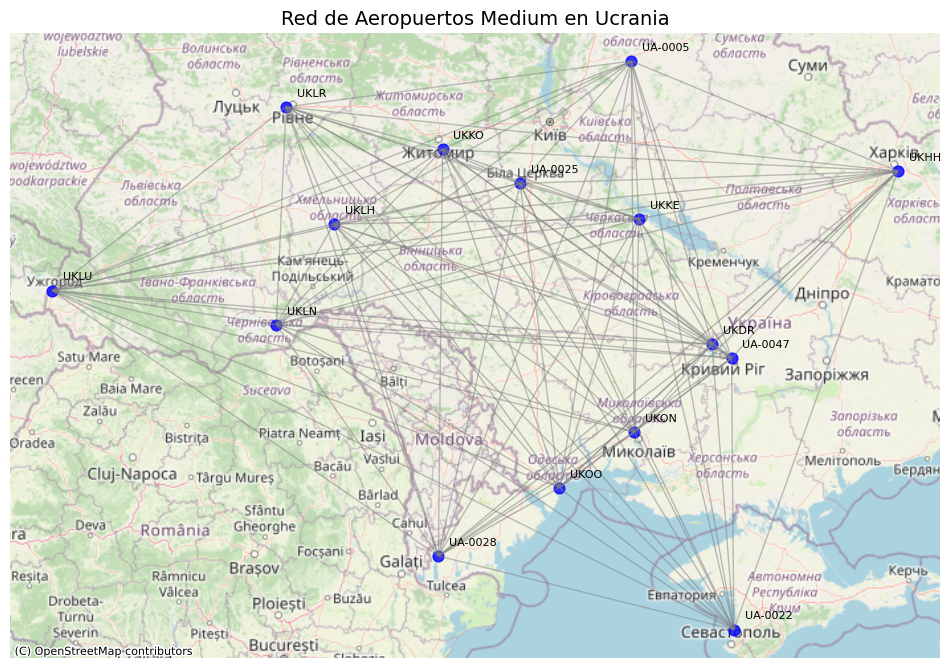

In [ ]:
# 1. Filtrar aeropuertos tipo medium_airport
medium_df = df[df['type'] == 'medium_airport'].copy()

# 2. Crear geometría de puntos
medium_df['geometry'] = [Point(xy) for xy in zip(medium_df['longitude_deg'], medium_df['latitude_deg'])]
gdf_medium = gpd.GeoDataFrame(medium_df, geometry='geometry', crs='EPSG:4326')

# 3. Crear líneas entre pares de nodos
edges = []
for (i, row1), (j, row2) in combinations(gdf_medium.iterrows(), 2):
    point1 = row1['geometry']
    point2 = row2['geometry']
    line = LineString([point1, point2])
    edges.append({'source': row1['ident'], 'target': row2['ident'], 'geometry': line})

# 4. Convertir a GeoDataFrame
gdf_edges = gpd.GeoDataFrame(edges, geometry='geometry', crs='EPSG:4326')

# 5. Proyección a Web Mercator
gdf_medium_web = gdf_medium.to_crs(epsg=3857)
gdf_edges_web = gdf_edges.to_crs(epsg=3857)

# 6. Dibujar mapa
fig, ax = plt.subplots(figsize=(12, 14))

# Líneas
gdf_edges_web.plot(ax=ax, color='gray', linewidth=1, alpha=0.5)

# Nodos
gdf_medium_web.plot(ax=ax, color='blue', markersize=60, alpha=0.8)

# Etiquetas
for x, y, label in zip(gdf_medium_web.geometry.x, gdf_medium_web.geometry.y, gdf_medium_web['ident']):
    ax.text(x + 20000, y + 20000, label, fontsize=8)

# Mapa base
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Título
plt.title("Red de Aeropuertos Medium en Ucrania", fontsize=14)
plt.axis('off')
plt.show()

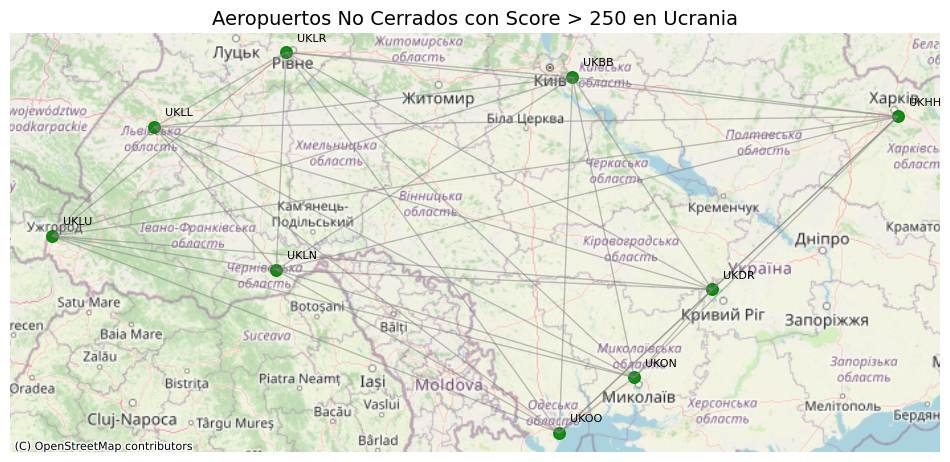

In [ ]:
# 1. Filtrar aeropuertos que NO están cerrados y tienen score > 250
filtered_df = df[(df['type'] != 'closed') & (df['score'] > 250)].copy()

# 2. Crear geometría de puntos
filtered_df['geometry'] = [Point(xy) for xy in zip(filtered_df['longitude_deg'], filtered_df['latitude_deg'])]
gdf_open = gpd.GeoDataFrame(filtered_df, geometry='geometry', crs='EPSG:4326')

# 3. Crear líneas entre pares de nodos
edges = []
for (i, row1), (j, row2) in combinations(gdf_open.iterrows(), 2):
    point1 = row1['geometry']
    point2 = row2['geometry']
    line = LineString([point1, point2])
    edges.append({'source': row1['ident'], 'target': row2['ident'], 'geometry': line})

# 4. Convertir a GeoDataFrame
gdf_edges = gpd.GeoDataFrame(edges, geometry='geometry', crs='EPSG:4326')

# 5. Proyección a Web Mercator
gdf_open_web = gdf_open.to_crs(epsg=3857)
gdf_edges_web = gdf_edges.to_crs(epsg=3857)

# 6. Dibujar mapa
fig, ax = plt.subplots(figsize=(12, 14))

# Líneas
gdf_edges_web.plot(ax=ax, color='gray', linewidth=1, alpha=0.5)

# Nodos abiertos con score > 250
gdf_open_web.plot(ax=ax, color='green', markersize=70, alpha=0.9)

# Etiquetas de nodos
for x, y, label in zip(gdf_open_web.geometry.x, gdf_open_web.geometry.y, gdf_open_web['ident']):
    ax.text(x + 20000, y + 20000, label, fontsize=8)

# Mapa base
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Título
plt.title("Aeropuertos No Cerrados con Score > 250 en Ucrania", fontsize=14)
plt.axis('off')
plt.show()

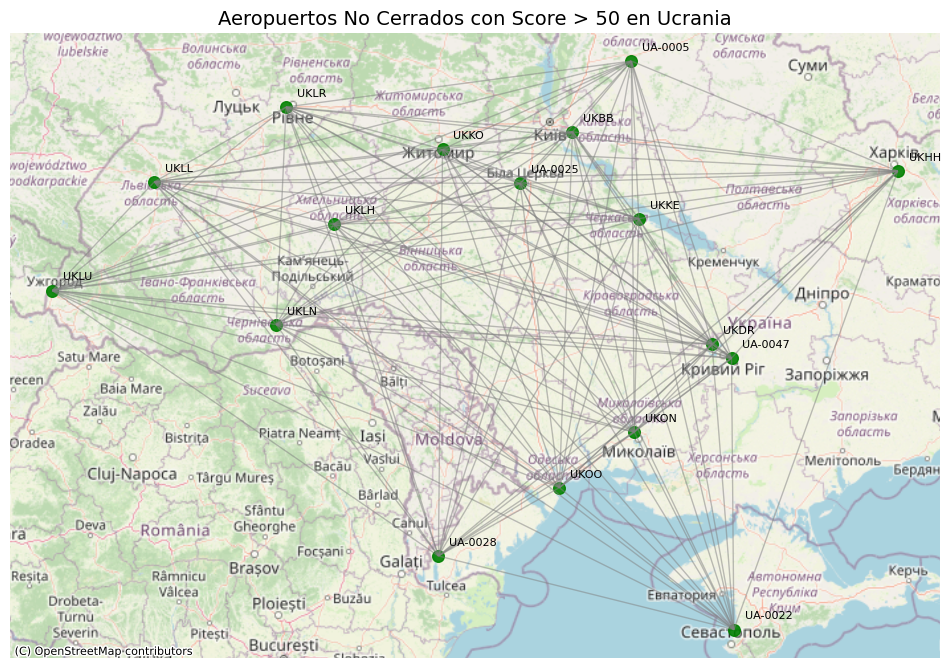

In [ ]:
# 1. Filtrar aeropuertos que NO están cerrados y tienen score > 50
filtered_df = df[(df['type'] != 'closed') & (df['score'] > 50)].copy()

# 2. Crear geometría de puntos
filtered_df['geometry'] = [Point(xy) for xy in zip(filtered_df['longitude_deg'], filtered_df['latitude_deg'])]
gdf_open = gpd.GeoDataFrame(filtered_df, geometry='geometry', crs='EPSG:4326')

# 3. Crear líneas entre pares de nodos
edges = []
for (i, row1), (j, row2) in combinations(gdf_open.iterrows(), 2):
    point1 = row1['geometry']
    point2 = row2['geometry']
    line = LineString([point1, point2])
    edges.append({'source': row1['ident'], 'target': row2['ident'], 'geometry': line})

# 4. Convertir a GeoDataFrame
gdf_edges = gpd.GeoDataFrame(edges, geometry='geometry', crs='EPSG:4326')

# 5. Proyección a Web Mercator
gdf_open_web = gdf_open.to_crs(epsg=3857)
gdf_edges_web = gdf_edges.to_crs(epsg=3857)

# 6. Dibujar mapa
fig, ax = plt.subplots(figsize=(12, 14))

# Líneas entre aeropuertos
gdf_edges_web.plot(ax=ax, color='gray', linewidth=1, alpha=0.5)

# Nodos
gdf_open_web.plot(ax=ax, color='green', markersize=70, alpha=0.9)

# Etiquetas de nodos
for x, y, label in zip(gdf_open_web.geometry.x, gdf_open_web.geometry.y, gdf_open_web['ident']):
    ax.text(x + 20000, y + 20000, label, fontsize=8)

# Mapa base
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Título
plt.title("Aeropuertos No Cerrados con Score > 50 en Ucrania", fontsize=14)
plt.axis('off')
plt.show()

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving hotosm_ukr_railways_lines_shp.zip to hotosm_ukr_railways_lines_shp.zip


In [ ]:
import zipfile
import os

with zipfile.ZipFile("hotosm_ukr_railways_lines_shp.zip", "r") as zip_ref:
    zip_ref.extractall("railways_data")

In [ ]:
import geopandas as gpd

# Leer shapefile con nombre completo y correcto
railways = gpd.read_file("railways_data/hotosm_ukr_railways_lines_shp.shp")

# Proyectar al mismo CRS que tu mapa (Web Mercator)
railways = railways.to_crs(epsg=3857)

# Verificar contenido
railways.head()

,name,name_en,railway,ele,operator_t,layer,addr_full,addr_city,source,name_uk,osm_id,osm_type,geometry
0,None,None,rail,None,None,None,None,None,None,None,909550098,ways_line,"LINESTRING (3171694.126 6320023.646, 3171639.7..."
1,None,None,rail,None,None,None,None,None,None,None,725678240,ways_line,"LINESTRING (3614663.156 5994502.534, 3614623.5..."
2,None,None,rail,None,None,None,None,None,None,None,696890387,ways_line,"LINESTRING (2477458.181 6205014.829, 2477516.1..."
3,None,None,rail,None,None,None,None,None,None,None,477228096,ways_line,"LINESTRING (2472812.708 6179274.18, 2472828.79..."
4,None,None,rail,None,None,None,None,None,None,None,477228104,ways_line,"LINESTRING (2472871.774 6179191.482, 2472902.4..."


In [ ]:
railways.plot(ax=ax, color='black', linewidth=1.2, alpha=0.6, label='Ferrocarriles')

<Axes: title={'center': 'Aeropuertos No Cerrados con Score > 50 en Ucrania'}>

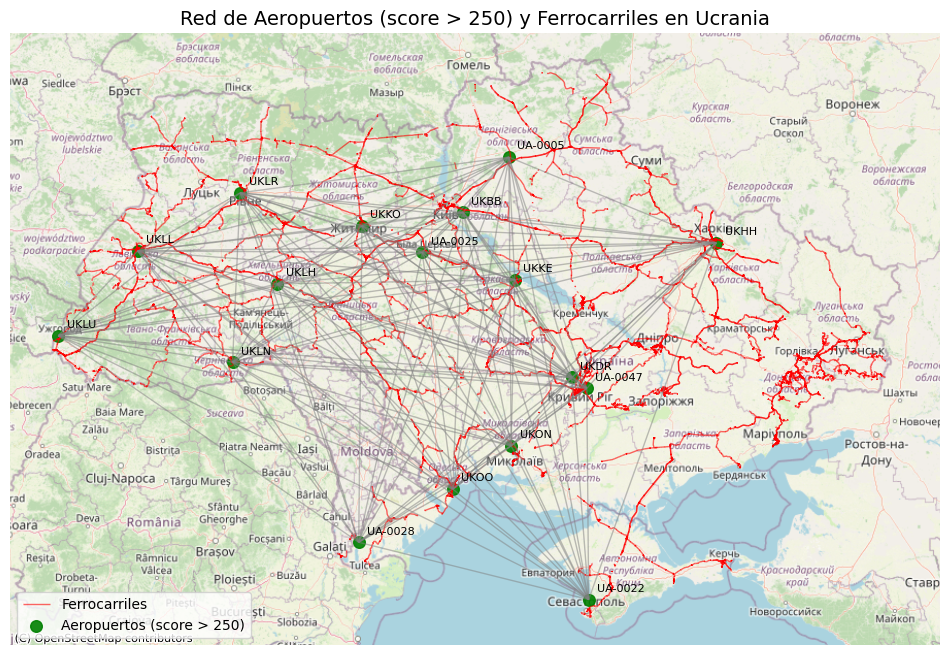

In [ ]:
import matplotlib.pyplot as plt
import geopandas as gpd
import contextily as ctx

# Asegúrate de tener ya cargados:
# gdf_open_web: GeoDataFrame de aeropuertos abiertos con score > 250 en EPSG:3857
# gdf_edges_web: GeoDataFrame de líneas entre aeropuertos (también en EPSG:3857)

# 1. Leer shapefile de ferrocarriles y reproyectar
railways = gpd.read_file("railways_data/hotosm_ukr_railways_lines_shp.shp")
railways = railways.to_crs(epsg=3857)

# 2. Crear el mapa
fig, ax = plt.subplots(figsize=(12, 14))

# Dibujar ferrocarriles
railways.plot(ax=ax, color='red', linewidth=1.0, alpha=0.6, label='Ferrocarriles')

# Dibujar las conexiones entre aeropuertos
gdf_edges_web.plot(ax=ax, color='gray', linewidth=1, alpha=0.5)

# Dibujar los aeropuertos abiertos con score > 250
gdf_open_web.plot(ax=ax, color='green', markersize=70, alpha=0.9, label='Aeropuertos (score > 250)')

# Etiquetas de los aeropuertos
for x, y, label in zip(gdf_open_web.geometry.x, gdf_open_web.geometry.y, gdf_open_web['ident']):
    ax.text(x + 20000, y + 20000, label, fontsize=8)

# Agregar mapa base
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Configurar título y leyenda
plt.title("Red de Aeropuertos (score > 250) y Ferrocarriles en Ucrania", fontsize=14)
plt.axis('off')
plt.legend(loc='lower left')
plt.show()

In [ ]:
from shapely.geometry import Point

# 1. Crear un buffer de 10 km (10000 m) alrededor de las líneas de ferrocarril
railways_buffer = railways.buffer(10000)

# 2. Unir todos los buffers en un solo objeto para facilitar el análisis
railways_union = railways_buffer.unary_union

# 3. Filtrar los aeropuertos que están dentro del buffer (o sea, cerca de ferrocarriles)
gdf_priority = gdf_open_web[gdf_open_web.geometry.within(railways_union)].copy()

/tmp/ipython-input-31-2342832669.py:7: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  railways_union = railways_buffer.unary_union


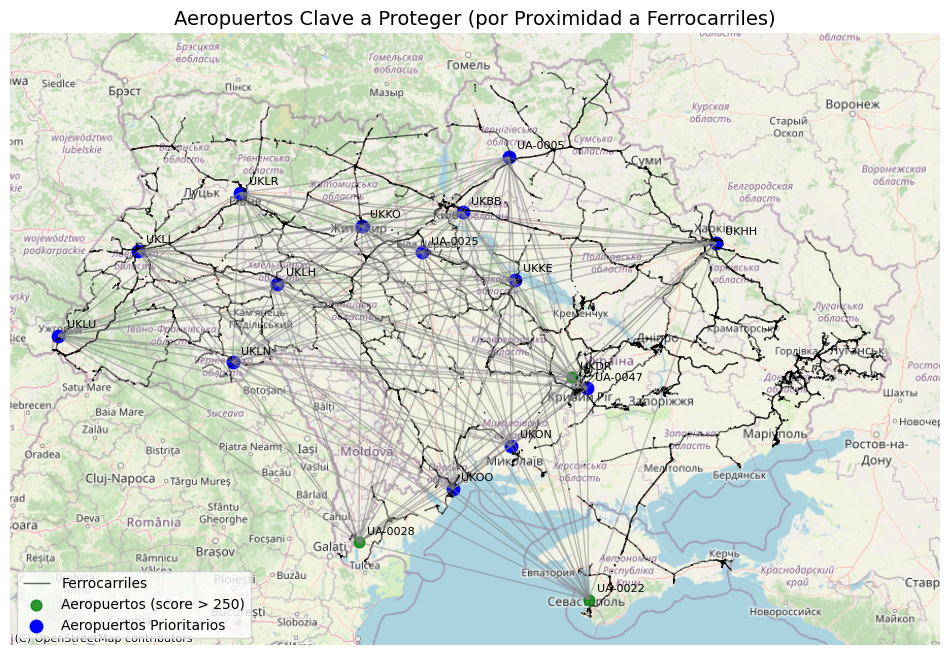

In [ ]:
# Crear el mapa
fig, ax = plt.subplots(figsize=(12, 14))

# Ferrocarriles
railways.plot(ax=ax, color='black', linewidth=1.0, alpha=0.6, label='Ferrocarriles')

# Conexiones
gdf_edges_web.plot(ax=ax, color='gray', linewidth=1, alpha=0.5)

# Aeropuertos normales (score > 250)
gdf_open_web.plot(ax=ax, color='green', markersize=60, alpha=0.8, label='Aeropuertos (score > 250)')

# Aeropuertos prioritarios (score > 250 y cerca de ferrocarril)
gdf_priority.plot(ax=ax, color='blue', markersize=80, alpha=1, label='Aeropuertos Prioritarios')

# Etiquetas
for x, y, label in zip(gdf_open_web.geometry.x, gdf_open_web.geometry.y, gdf_open_web['ident']):
    ax.text(x + 20000, y + 20000, label, fontsize=8)

# Mapa base
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Título y leyenda
plt.title("Aeropuertos Clave a Proteger (por Proximidad a Ferrocarriles)", fontsize=14)
plt.axis('off')
plt.legend(loc='lower left')
plt.show()

In [ ]:
# 1. Crear buffer alrededor de cada línea ferroviaria (por ejemplo 40 km)
railways['buffer'] = railways.geometry.buffer(900000)

# 2. Contar cuántos aeropuertos con score > 250 hay dentro del buffer de cada línea
airport_points = gdf_open_web.copy()
railways['airport_count'] = railways['buffer'].apply(lambda buf: airport_points.geometry.within(buf).sum())

# 3. Eliminar la columna de buffer (ya no se necesita)
railways.drop(columns='buffer', inplace=True)

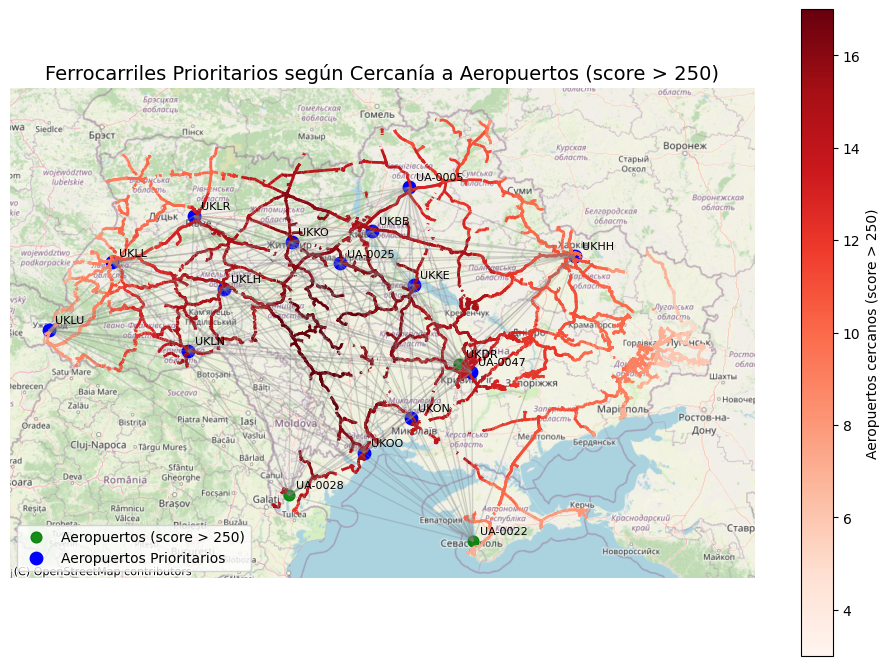

In [ ]:
# Mapa
fig, ax = plt.subplots(figsize=(12, 14))

# 1. Dibujar líneas ferroviarias con color según cantidad de aeropuertos cercanos
railways.plot(ax=ax, column='airport_count', cmap='Reds', linewidth=2, legend=True,
              legend_kwds={'label': "Aeropuertos cercanos (score > 250)", 'shrink': 0.6})

# 2. Dibujar conexiones entre aeropuertos
gdf_edges_web.plot(ax=ax, color='gray', linewidth=1, alpha=0.3)

# 3. Aeropuertos
gdf_open_web.plot(ax=ax, color='green', markersize=60, alpha=0.9, label='Aeropuertos (score > 250)')

# 4. Aeropuertos prioritarios (cerca de ferrocarriles)
gdf_priority.plot(ax=ax, color='blue', markersize=80, alpha=1, label='Aeropuertos Prioritarios')

# Etiquetas de nodos
for x, y, label in zip(gdf_open_web.geometry.x, gdf_open_web.geometry.y, gdf_open_web['ident']):
    ax.text(x + 20000, y + 20000, label, fontsize=8)

# Fondo de mapa
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Título y leyenda
plt.title("Ferrocarriles Prioritarios según Cercanía a Aeropuertos (score > 250)", fontsize=14)
plt.axis('off')
plt.legend(loc='lower left')
plt.show()

In [ ]:
# 1. Filtrar aeropuertos cerrados (atacados)
df_closed = df[df['type'] == 'closed'].copy()

# 2. Crear geometría
df_closed['geometry'] = [Point(xy) for xy in zip(df_closed['longitude_deg'], df_closed['latitude_deg'])]

# 3. GeoDataFrame y proyección
gdf_closed = gpd.GeoDataFrame(df_closed, geometry='geometry', crs='EPSG:4326')
gdf_closed_web = gdf_closed.to_crs(epsg=3857)

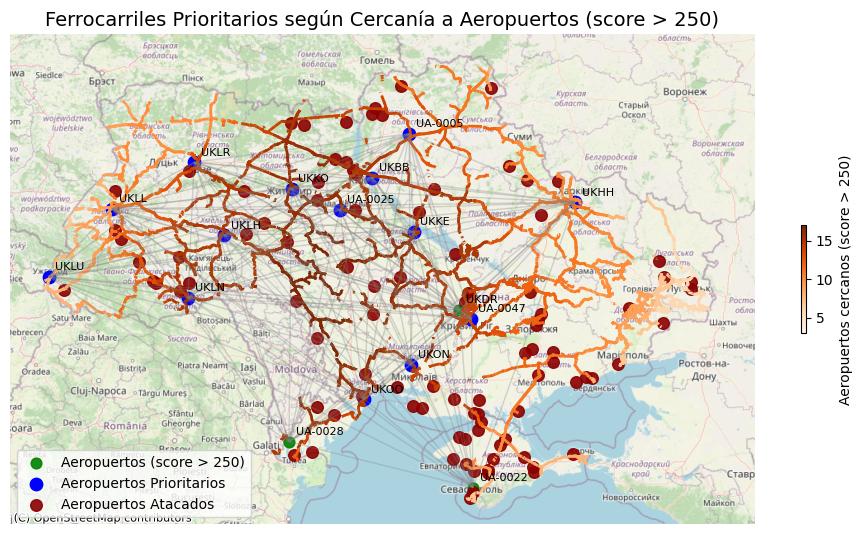

In [ ]:
# Mapa
fig, ax = plt.subplots(figsize=(12, 14))

# 1. Dibujar líneas ferroviarias con color según cantidad de aeropuertos cercanos
railways.plot(ax=ax, column='airport_count', cmap='Oranges', linewidth=2, legend=True,
              legend_kwds={'label': "Aeropuertos cercanos (score > 250)", 'shrink': 0.1})

# 2. Dibujar conexiones entre aeropuertos
gdf_edges_web.plot(ax=ax, color='gray', linewidth=1, alpha=0.3)

# 3. Aeropuertos
gdf_open_web.plot(ax=ax, color='green', markersize=60, alpha=0.9, label='Aeropuertos (score > 250)')

# 4. Aeropuertos prioritarios (cerca de ferrocarriles)
gdf_priority.plot(ax=ax, color='blue', markersize=80, alpha=1, label='Aeropuertos Prioritarios')

# 5. Aeropuertos atacados (cerrados)
gdf_closed_web.plot(ax=ax, color='darkred', markersize=70, alpha=0.9, label='Aeropuertos Atacados')

# Etiquetas de nodos
for x, y, label in zip(gdf_open_web.geometry.x, gdf_open_web.geometry.y, gdf_open_web['ident']):
    ax.text(x + 20000, y + 20000, label, fontsize=8)

# Fondo de mapa
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Título y leyenda
plt.title("Ferrocarriles Prioritarios según Cercanía a Aeropuertos (score > 250)", fontsize=14)
plt.axis('off')
plt.legend(loc='lower left')
plt.show()

In [ ]:
# 1. Filtrar aeropuertos cerrados (atacados)
df_closed = df[(df['type'] == 'closed') & (df['score'] > 0)].copy()

# 2. Crear geometría
df_closed['geometry'] = [Point(xy) for xy in zip(df_closed['longitude_deg'], df_closed['latitude_deg'])]

# 3. GeoDataFrame y proyección
gdf_closed = gpd.GeoDataFrame(df_closed, geometry='geometry', crs='EPSG:4326')
gdf_closed_web = gdf_closed.to_crs(epsg=3857)

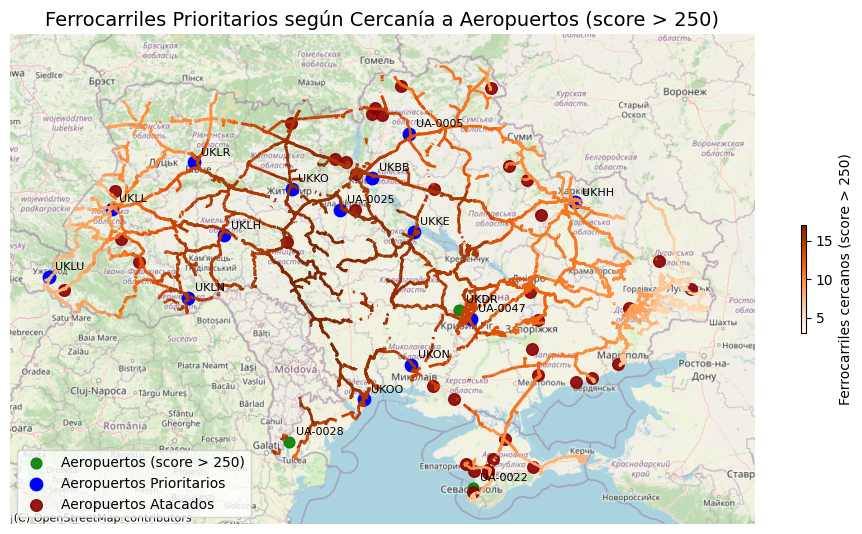

In [ ]:
# Mapa
fig, ax = plt.subplots(figsize=(12, 14))

# 1. Dibujar líneas ferroviarias con color según cantidad de aeropuertos cercanos
railways.plot(ax=ax, column='airport_count', cmap='Oranges', linewidth=2, legend=True,
              legend_kwds={'label': "Ferrocarriles cercanos (score > 250)", 'shrink': 0.1})

# 3. Aeropuertos
gdf_open_web.plot(ax=ax, color='green', markersize=60, alpha=0.9, label='Aeropuertos (score > 250)')

# 4. Aeropuertos prioritarios (cerca de ferrocarriles)
gdf_priority.plot(ax=ax, color='blue', markersize=80, alpha=1, label='Aeropuertos Prioritarios')

# 5. Aeropuertos atacados (cerrados)
gdf_closed_web.plot(ax=ax, color='darkred', markersize=70, alpha=0.9, label='Aeropuertos Atacados')

# Etiquetas de nodos
for x, y, label in zip(gdf_open_web.geometry.x, gdf_open_web.geometry.y, gdf_open_web['ident']):
    ax.text(x + 20000, y + 20000, label, fontsize=8)

# Fondo de mapa
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Título y leyenda
plt.title("Ferrocarriles Prioritarios según Cercanía a Aeropuertos (score > 250)", fontsize=14)
plt.axis('off')
plt.legend(loc='lower left')
plt.show()

In [ ]:
# 1. Filtrar aeropuertos cerrados (atacados)
df_closed = df[(df['type'] == 'closed') & (df['score'] > 50)].copy()

# 2. Crear geometría
df_closed['geometry'] = [Point(xy) for xy in zip(df_closed['longitude_deg'], df_closed['latitude_deg'])]

# 3. GeoDataFrame y proyección
gdf_closed = gpd.GeoDataFrame(df_closed, geometry='geometry', crs='EPSG:4326')
gdf_closed_web = gdf_closed.to_crs(epsg=3857)

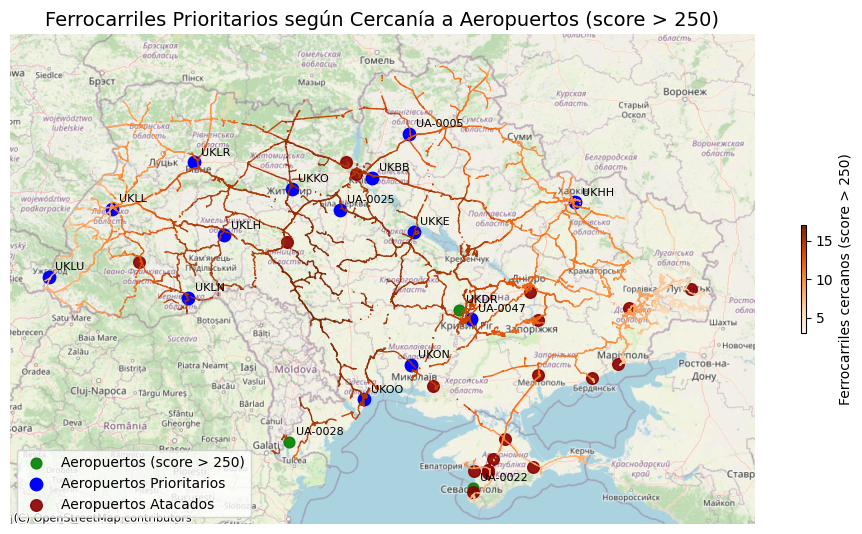

In [ ]:
# Mapa
fig, ax = plt.subplots(figsize=(12, 14))

# 1. Dibujar líneas ferroviarias con color según cantidad de aeropuertos cercanos
railways.plot(ax=ax, column='airport_count', cmap='Oranges', linewidth=1, legend=True,
              legend_kwds={'label': "Ferrocarriles cercanos (score > 250)", 'shrink': 0.1})

# 3. Aeropuertos
gdf_open_web.plot(ax=ax, color='green', markersize=60, alpha=0.9, label='Aeropuertos (score > 250)')

# 4. Aeropuertos prioritarios (cerca de ferrocarriles)
gdf_priority.plot(ax=ax, color='blue', markersize=80, alpha=1, label='Aeropuertos Prioritarios')

# 5. Aeropuertos atacados (cerrados)
gdf_closed_web.plot(ax=ax, color='darkred', markersize=70, alpha=0.9, label='Aeropuertos Atacados')

# Etiquetas de nodos
for x, y, label in zip(gdf_open_web.geometry.x, gdf_open_web.geometry.y, gdf_open_web['ident']):
    ax.text(x + 20000, y + 20000, label, fontsize=8)

# Fondo de mapa
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Título y leyenda
plt.title("Ferrocarriles Prioritarios según Cercanía a Aeropuertos (score > 250)", fontsize=14)
plt.axis('off')
plt.legend(loc='lower left')
plt.show()